# Molecular Orbitals from Hartree-Fock Calculations

Simple Juypter notebook that performs Hartree-Fock calculations using pyscf.

Part of the code take from and inspired by https://www.andersle.no/posts/2022/mo/mo.html

## Setup python environment and imports

In [1]:
%%capture
!pip install numpy
!pip install scipy
!pip install Cython
!pip install pandas
!pip install sklearn
!pip install statsmodels
!pip install matplotlib
!pip install seaborn
!pip install rdkit
!pip install py3Dmol
!pip install ipywidgets
!pip install sphinx
!pip install nbsphinx
!pip install pydata-sphinx-theme
!pip install lxml
!pip install fortecubeview
!pip install pythreejs
!pip install scikit-image
!pip install pyscf
!pip install shap
!pip install catboost
!pip install graphviz

In [2]:
import pathlib

# RDKit imports:
from rdkit import Chem
from rdkit.Chem import (
    AllChem,
    rdCoordGen,
)
from rdkit.Chem.Draw import IPythonConsole

IPythonConsole.ipython_useSVG = True  # Use higher quality images for molecules

# For visualization of molecules and orbitals:
import py3Dmol
import fortecubeview

# pyscf imports:
import pyscf

# For plotting
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set_theme(style="ticks", context="talk", palette="muted")

# For numerics:
import numpy as np
import pandas as pd

from google.colab import output
output.enable_custom_widget_manager()

pd.options.display.float_format = "{:,.3f}".format

## Definition of Molecule from SMILES String

**Here you should define the smiles string for the molecule you want to consider**




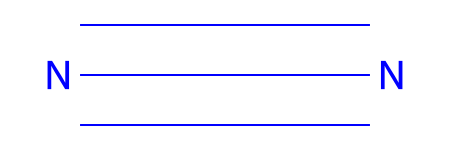

In [25]:
molecule_smiles = "N#N" #@param {type:"string"}

molecule_name = "Mol"
molecule = Chem.MolFromSmiles(molecule_smiles)  # Generate the molecule from smiles
molecule

## Setup of Molecule

In [29]:
def get_xyz(molecule, optimize=False):
    """Get xyz-coordinates for the molecule"""
    mol = Chem.Mol(molecule)
    mol = AllChem.AddHs(mol, addCoords=True)
    AllChem.EmbedMolecule(mol)
    if optimize:  # Optimize the molecules with the MM force field:
        AllChem.MMFFOptimizeMolecule(mol)
    xyz = []
    for lines in Chem.MolToXYZBlock(mol).split("\n")[2:]:
        strip = lines.strip()
        if strip:
            xyz.append(strip)
    xyz = "\n".join(xyz)
    return mol, xyz

In [28]:
molecule3d, xyz = get_xyz(molecule, optimize=True)
print(xyz)

N      0.730000    0.000000    0.000000
N     -0.730000    0.000000    0.000000


In [30]:
view = py3Dmol.view(
    data=Chem.MolToMolBlock(molecule3d),
    style={"stick": {}, "sphere": {"scale": 0.3}},
    width=300,
    height=300,
)
view.zoomTo()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## Hartree-Fock Calculations

In [31]:
def run_calculation(xyz, basis="sto-3g"):
    """Calculate the energy (+ additional things like MO coefficients) with pyscf."""
    mol = pyscf.gto.M(
        atom=xyz,
        basis=basis,
        unit="ANG",
        symmetry=False,
    )
    mol.build()
    mf = pyscf.scf.RHF(mol).run()
    return mf, mol

In [43]:
mf, mol = run_calculation(xyz, basis="cc-pvdz")

converged SCF energy = -108.711033101289


## Analysis of Results

In [44]:
mf.analyze(verbose=4)

**** SCF Summaries ****
Total Energy =                        -108.711033101289217
Nuclear Repulsion Energy =              17.760057078821919
One-electron Energy =                 -182.455477660068198
Two-electron Energy =                   55.984387479957064
**** MO energy ****
MO #1   energy= -15.7778264733255  occ= 2
MO #2   energy= -15.7769917795231  occ= 2
MO #3   energy= -1.24969601967816  occ= 2
MO #4   energy= -0.876403090546634 occ= 2
MO #5   energy= -0.578323693376467 occ= 2
MO #6   energy= -0.492055375569743 occ= 2
MO #7   energy= -0.492055375569742 occ= 2
MO #8   energy= 0.0257645956185183 occ= 0
MO #9   energy= 0.0257645956185184 occ= 0
MO #10  energy= 0.335937899537954  occ= 0
MO #11  energy= 0.873539334480828  occ= 0
MO #12  energy= 0.919482173703314  occ= 0
MO #13  energy= 0.919482173703315  occ= 0
MO #14  energy= 0.938809070280875  occ= 0
MO #15  energy= 1.00394290529739   occ= 0
MO #16  energy= 1.00394290529739   occ= 0
MO #17  energy= 1.00716989179797   occ= 0
MO #18

((array([1.99999293e+00, 1.81434441e+00, 4.78163420e-03, 1.17531743e+00,
         9.92305383e-01, 9.92305383e-01, 1.34643941e-03, 4.53131707e-03,
         4.53131707e-03, 3.16330035e-03, 1.11671294e-31, 1.05428841e-03,
         3.16330035e-03, 3.16286522e-03, 1.99999293e+00, 1.81434441e+00,
         4.78163420e-03, 1.17531743e+00, 9.92305383e-01, 9.92305383e-01,
         1.34643941e-03, 4.53131707e-03, 4.53131707e-03, 3.16330035e-03,
         8.24118157e-33, 1.05428841e-03, 3.16330035e-03, 3.16286522e-03]),
  array([-4.05897538e-13,  4.06785716e-13])),
 array([-2.75557408e-12, -3.00960313e-15,  1.62460811e-15]))

In [38]:
table = pd.DataFrame({"Energy": mf.mo_energy, "Occupancy": mf.mo_occ})
table

,Energy,Occupancy
0,-15.439,2.000
1,-15.438,2.000
2,-1.164,2.000
3,-0.774,2.000
4,-0.449,2.000
5,-0.381,2.000
6,-0.381,2.000
7,0.159,0.000
8,0.159,0.000
9,0.549,0.000


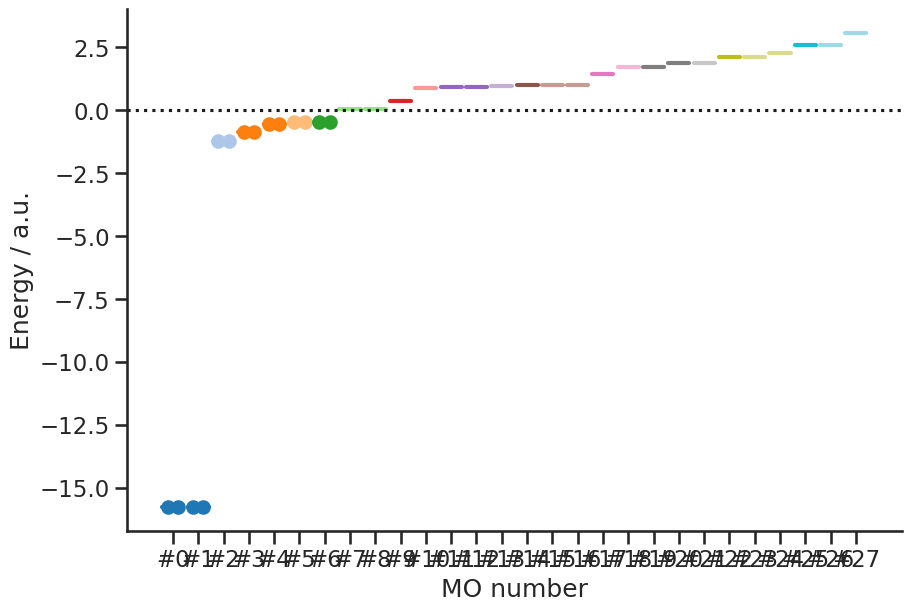

In [45]:
fig, ax = plt.subplots(constrained_layout=True, figsize=(9, 6))
colors = matplotlib.colormaps.get_cmap("tab20")(np.linspace(0, 1, len(mf.mo_energy)))

pos = []
for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
    left = 3 * i
    right = 3 * i + 2.5
    length = right - left

    (line,) = ax.plot([left, right], [energy, energy], color=colors[i], lw=3)

    electron_x, electron_y = None, None
    if occ == 2:
        electron_x = [left + 0.25 * length, left + 0.75 * length]
        electron_y = [energy, energy]
    elif occ == 1:
        electron_x, electron_y = [left + 0.5], [energy]
    if electron_x and electron_y:
        ax.scatter(electron_x, electron_y, color=line.get_color())

    pos.append(left + 0.5 * length)

ax.axhline(y=0, ls=":", color="k")
ax.set_xticks(pos)
ax.set_xticklabels([f"#{i}" for i, _ in enumerate(pos)])
ax.set(xlabel="MO number", ylabel="Energy / a.u.")
sns.despine(fig=fig)

## Setup Orbitals

In [40]:
def write_cube_files(
    max_homo_lumo=5, prefix="", dirname=".", margin=5, write_all_orbitals=False
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    # find index of HOMO and LUMO
    lumo = float("inf")
    lumo_idx = None
    homo = -float("inf")
    homo_idx = None
    for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
        if occ > 0 and energy > homo:
            homo = energy
            homo_idx = i
        if occ == 0 and energy < lumo:
            lumo = energy
            lumo_idx = i

    if(write_all_orbitals):
      for i in range(mf.mo_coeff.shape[1]):
        outfile = f"{prefix}Orbital-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, i], margin=margin)
    else:
      print(f"HOMO (index): {homo_idx}")
      print(f"LUMO (index): {lumo_idx}")
      print("")
      outfile = f"{prefix}HOMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx], margin=margin)

      outfile = f"{prefix}LUMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx], margin=margin)

      for i in range(1,max_homo_lumo+1):
        outfile = f"{prefix}HOMO_minus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx-i], margin=margin)

        outfile = f"{prefix}LUMO_plus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        pyscf.tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx+i], margin=margin)

In [41]:
!rm -rf cube_files
write_cube_files(
   dirname="cube_files",
   write_all_orbitals=True
)

Writing cube_files/Orbital-00.cube
Writing cube_files/Orbital-01.cube
Writing cube_files/Orbital-02.cube
Writing cube_files/Orbital-03.cube
Writing cube_files/Orbital-04.cube
Writing cube_files/Orbital-05.cube
Writing cube_files/Orbital-06.cube
Writing cube_files/Orbital-07.cube
Writing cube_files/Orbital-08.cube
Writing cube_files/Orbital-09.cube


## Visualize Orbitals

In [42]:
fortecubeview.plot(path="./cube_files/", width=600, height=300, colorscheme='national')

CubeViewer: listing cube files from the directory ./cube_files/
Reading 10 cube files


HTML(value='\n        <style>\n           .jupyter-widgets-output-area .output_scroll {\n                heigh…

interactive(children=(Select(description='Cube files:', options=('./cube_files/Orbital-00.cube', './cube_files…

TraitError: The 'target' trait of a DirectionalLight instance expected an Uninitialized or an Object3D, not the str 'IPY_MODEL_4a581d17-a51d-4d84-b23e-44d6d162bb18'.